<span style="color:#1ABC9C; font-size:2em; font-weight:bold;">Marjan Atashkar</span>

---

<span style="color:#2E86C1; font-size:1.8em; font-weight:bold;">🔍 Project Overview: Credit Card Customer Segmentation</span>


<span style="color:#27AE60; font-size:2em; font-weight:bold;">📊 Introduction</span>  
In this project, we aim to analyze customer data to uncover meaningful patterns and segments that can inform targeted marketing strategies. Since our dataset does not include any predefined target variables, we will employ unsupervised learning techniques, specifically using the **K-Means clustering algorithm** for modeling.

---

<span style="color:#3498DB; font-size:1.5em; font-weight:bold;">🔑 Key Features</span>  

Here's an overview of the key columns in the dataset:

- <span style="color:#27AE60;">**💳 BALANCE**</span>: The current amount owed by the cardholder.
- <span style="color:#27AE60;">**📅 BALANCE_FREQUENCY**</span>: How regularly the balance is updated (values between 0 and 1).
- <span style="color:#27AE60;">**💸 PURCHASES**</span>: The total amount spent using the credit card.
- <span style="color:#27AE60;">**🛍️ ONEOFF_PURCHASES**</span>: Total amount of non-installment purchases in a single transaction.
- <span style="color:#27AE60;">**📆 INSTALLMENTS_PURCHASES**</span>: Total purchases made through installment payments.
- <span style="color:#27AE60;">**💵 CASH_ADVANCE**</span>: Total amount of cash withdrawals made from the credit card.
- <span style="color:#27AE60;">**📊 PURCHASES_FREQUENCY**</span>: Frequency of purchases over time.
- <span style="color:#27AE60;">**🔄 ONEOFF_PURCHASES_FREQUENCY**</span>: How often single, one-off purchases are made.
- <span style="color:#27AE60;">**💳 CREDIT_LIMIT**</span>: The upper limit of the credit available to the cardholder.
- <span style="color:#27AE60;">**💰 PAYMENTS**</span>: The total payments made towards the credit card balance.
- <span style="color:#27AE60;">**⚖️ MINIMUM_PAYMENTS**</span>: Minimum required payments made on the credit balance.
- <span style="color:#27AE60;">**🔢 PRC_FULL_PAYMENT**</span>: Proportion of times full balance payment was made.
- <span style="color:#27AE60;">**⏳ TENURE**</span>: The duration of time (in months) the credit card has been active.

---

<span style="color:#F39C12; font-size:1.5em; font-weight:bold;">🔍 K-Means Clustering</span>  
**K-Means** is a widely-used and efficient clustering algorithm that groups data into **K clusters** based on similarity. The goal is to minimize the distance between points within a cluster and the cluster’s centroid. Our approach will involve:

- **📏 Standardizing Features:** We will standardize the features to ensure consistency and enhance the effectiveness of our clustering results.
- **⚙️ Applying K-Means:** We will experiment with different values of **K** to determine the optimal number of clusters that best represent the underlying patterns in our data.

---

<span style="color:#F39C12; font-size:1.5em; font-weight:bold;">📊 Silhouette Analysis</span>  
To evaluate the quality of the clusters formed, we will utilize **Silhouette Analysis**. This technique assesses how well each data point is grouped by comparing the intra-cluster distance (distance within clusters) to the inter-cluster distance (distance between clusters). A higher silhouette score suggests better-defined clusters.

---

💡 <span style="font-weight:bold; color:#27AE60;">Final Thoughts</span>  
By employing clustering techniques like **K-Means** and **Silhouette Analysis**, our goal is to:

- Identify customer segments that can be leveraged for targeted marketing strategies and personalized services.
- Gain insights into customer behaviors and trends through data-driven analysis, enabling more precise customer engagement strategies.


# 

<span style="color:#1F618D; font-size:1.8em; font-weight:bold;">📚 Import Libraries</span>


In [1]:
import numpy as np
import warnings
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
!pip install kneed
from kneed import KneeLocator
from sklearn.preprocessing import  StandardScaler
from sklearn import metrics
from sklearn.metrics import silhouette_score
#warnings
import warnings
warnings.simplefilter(action='ignore')

<span style="color:#E67E22; font-size:1.8em; font-weight:bold;">📥 Read Data</span>


In [2]:
data = pd.read_csv("/kaggle/input/customer-data/Customer_Data.csv" )
Data = pd.DataFrame(data)
Data

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


<span style="color:#9B59B6; font-size:1.8em; font-weight:bold;">🛠️ Data Preprocessing</span>


In [3]:
Data.describe(include = "all")

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
unique,8950,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,C10001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,NaN,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,NaN,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,NaN,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,NaN,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000


In [4]:
Data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

<span style="color:#E74C3C; font-size:1.8em; font-weight:bold;">❓ Missing Value</span>


In [5]:
Data.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

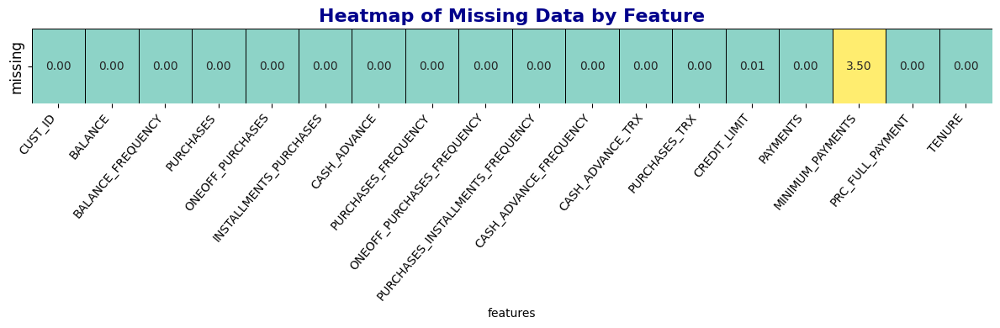

In [6]:
missing_df = pd.DataFrame({
    'features': ['CUST_ID', 'BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
                 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY', 
                 'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY', 
                 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 
                 'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE'],
    'missing': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, (1 / 8950) * 100, 0, (313 / 8950) * 100, 0, 0]
})

plt.figure(figsize=(12, 4))  

sns.heatmap(missing_df.set_index('features').T, annot=True, fmt=".2f", cmap='Set3', 
            linewidths=0.5, linecolor='black', cbar=False, annot_kws={"size": 10})

plt.title('Heatmap of Missing Data by Feature', fontsize=16, fontweight='bold', color='darkblue')
plt.xticks(rotation=50, ha='right', fontsize=10)
plt.yticks(fontsize=12)

plt.tight_layout()
plt.show()

<span style="color:#8E44AD; font-size:1.2em;">🔍 **Missing Value Analysis:**</span>

As we can see, the <span style="color:#E67E22; font-weight:bold;">'CREDIT_LIMIT'</span> column has a missing value rate of <span style="color:#E67E22; font-weight:bold;">0.1%</span>, while the <span style="color:#E67E22; font-weight:bold;">'MINIMUM_PAYMENTS'</span> column exhibits a missing value rate of <span style="color:#E67E22; font-weight:bold;">3.5%</span>, with a total of <span style="color:#E67E22; font-weight:bold;">313 missing values</span>.


# 

In [7]:
# checking the value which is Null for Credit Limit
Data[Data['CREDIT_LIMIT'].isnull()]

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
5203,C15349,18.400472,0.166667,0.0,0.0,0.0,186.853063,0.0,0.0,0.0,0.166667,1,0,NaN,9.040017,14.418723,0.0,6


In [8]:
# dropping off the missing value for Credit Limit
Data.drop(5203, inplace=True)

<span style="color:#8E44AD; font-size:1.2em;">🔧 **Data Cleaning Action:**</span>

To ensure the integrity of our dataset, we have removed the row with the index <span style="color:#E67E22; font-weight:bold;">**5203**</span>, which contains a missing value in the <span style="color:#E67E22; font-weight:bold;">**'CREDIT_LIMIT'**</span> column. This action helps maintain the quality of our analysis by eliminating incomplete data points that could skew our results.


# 

In [9]:
# Selecting rows with missing values.
missing_data = Data[Data['MINIMUM_PAYMENTS'].isnull()]
missing_data

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.0,12
45,C10047,2242.311686,1.000000,437.00,97.00,340.0,184.648692,0.333333,0.083333,0.333333,0.166667,2,5,2400.0,0.000000,NaN,0.0,12
47,C10049,3910.111237,1.000000,0.00,0.00,0.0,1980.873201,0.000000,0.000000,0.000000,0.500000,7,0,4200.0,0.000000,NaN,0.0,12
54,C10056,6.660517,0.636364,310.00,0.00,310.0,0.000000,0.666667,0.000000,0.666667,0.000000,0,8,1000.0,417.016763,NaN,0.0,12
55,C10057,1311.995984,1.000000,1283.90,1283.90,0.0,0.000000,0.250000,0.250000,0.000000,0.000000,0,6,6000.0,0.000000,NaN,0.0,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8919,C19160,14.524779,0.333333,152.00,152.00,0.0,0.000000,0.333333,0.333333,0.000000,0.000000,0,2,1500.0,0.000000,NaN,0.0,6
8929,C19170,371.527312,0.333333,0.00,0.00,0.0,1465.407927,0.000000,0.000000,0.000000,0.166667,5,0,1500.0,0.000000,NaN,0.0,6
8935,C19176,183.817004,1.000000,465.90,0.00,465.9,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1500.0,0.000000,NaN,0.0,6
8944,C19185,193.571722,0.833333,1012.73,1012.73,0.0,0.000000,0.333333,0.333333,0.000000,0.000000,0,2,4000.0,0.000000,NaN,0.0,6


In [10]:
Data[['PAYMENTS', 'MINIMUM_PAYMENTS']][Data['MINIMUM_PAYMENTS'].isna()]

,PAYMENTS,MINIMUM_PAYMENTS
3,0.000000,NaN
45,0.000000,NaN
47,0.000000,NaN
54,417.016763,NaN
55,0.000000,NaN
...,...,...
8919,0.000000,NaN
8929,0.000000,NaN
8935,0.000000,NaN
8944,0.000000,NaN


<span style="color:#2E86C1; font-size:1.4em; font-weight:bold;">🔍 **Analysis Objective:**</span>

Our objective is to compare the columns <span style="color:#E67E22; font-weight:bold;">**"PAYMENTS"**</span> and <span style="color:#E67E22; font-weight:bold;">**"MINIMUM_PAYMENTS"**</span>, focusing specifically on the entries that contain missing (null) values. This analysis will help us understand the implications of these missing values and their potential impact on our overall data interpretation.


# 

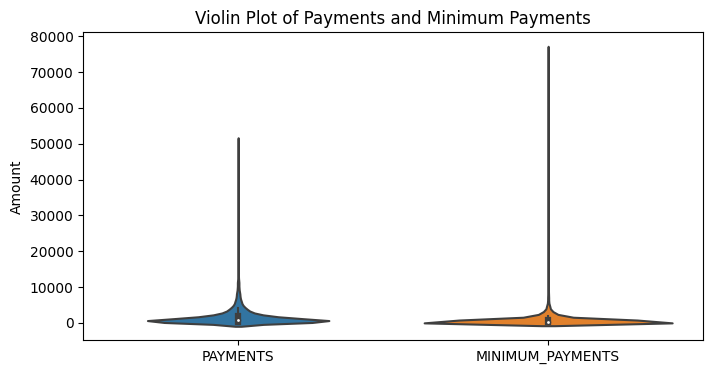

In [11]:
# Violin plot for Payments and Minimum Payments
plt.figure(figsize=(8, 4))
sns.violinplot(data=Data[['PAYMENTS', 'MINIMUM_PAYMENTS']])
plt.title('Violin Plot of Payments and Minimum Payments')
plt.ylabel('Amount')
plt.show()

### <span style="color:#27AE60;">Analysis of Violin Plot 🎻</span>

Based on the violin plot, we can conclude that our analysis is correct, as both the <span style="color:#F39C12;">Payments 💵</span> and <span style="color:#F39C12;">Minimum Payments 💳</span> columns show similar distributions. This indicates that the two variables are dependent on each other.

The similarity in their shapes suggests that individuals tend to make payments close to their <span style="color:#F39C12;">minimum payment</span> amounts. Additionally, the stretch in the <span style="color:#F39C12;">Minimum Payments 💳</span> column indicates that while some customers stick to their minimum payments, there are also individuals who make higher payments.

Thus, we can confirm that these two columns are related and provide further insights into customer payment behavior.


# 

In [12]:
# Select data where minimum payments are specified and payments are greater than the minimum payments
filtered_data = Data[Data['MINIMUM_PAYMENTS'].notna() & (Data['PAYMENTS'] > Data['MINIMUM_PAYMENTS'])]

print('Shape:', filtered_data.shape)

filtered_data[['PAYMENTS', 'MINIMUM_PAYMENTS']].head(10)

Shape: (6272, 18)


,PAYMENTS,MINIMUM_PAYMENTS
0,201.802084,139.509787
1,4103.032597,1072.340217
4,678.334763,244.791237
6,6354.314328,198.065894
7,679.065082,532.033990
8,688.278568,311.963409
9,1164.770591,100.302262
11,705.618627,155.549069
12,608.263689,490.207013
13,1655.891435,251.137986


<span style="color:#2E86C1; font-size:1.4em; font-weight:bold;">📊 **Data Selection Insight:**</span>

We selected the entries in the dataset where minimum payments are specified, and the actual payments made exceed these minimum amounts. This results in a total of <span style="color:#E67E22; font-weight:bold;">**6,272**</span> data points that meet this criteria, highlighting a significant number of instances where customers are making payments above the required minimum.

<span style="color:#2E86C1; font-size:1.4em; font-weight:bold;">🔧 **Addressing Missing Values:**</span>

We added this code to address the <span style="color:#E67E22; font-weight:bold;">**313 missing values**</span>, as removing data can decrease modeling accuracy. We aim to minimize data loss as much as possible.


# 

In [13]:
# Select data where minimum payments are specified and payments are less than the minimum payments

filtered_payments_below_minimum = Data[(Data['MINIMUM_PAYMENTS'].notna()) & (Data['PAYMENTS'] < Data['MINIMUM_PAYMENTS'])]

print('Shape:', filtered_payments_below_minimum.shape)

filtered_payments_below_minimum[['PAYMENTS', 'MINIMUM_PAYMENTS']].head(10)


Shape: (2364, 18)


,PAYMENTS,MINIMUM_PAYMENTS
2,622.066742,627.284787
5,1400.057770,2407.246035
10,1083.301007,2172.697765
14,805.647974,989.962866
15,1993.439277,2109.906490
19,1053.980464,12465.549380
20,223.068600,13557.297260
24,1422.726707,1657.002877
26,890.178845,971.183209
28,1601.448347,1648.851345


<span style="color:#2E86C1; font-size:1.4em; font-weight:bold;">🔍 **Customer Payment Analysis:**</span>

Alternatively, we identified <span style="color:#E67E22; font-weight:bold;">**2,364 customers**</span> whose payments fell below the specified minimum payments, resulting in invalid values. However, we have decided to retain these entries as they may provide valuable insights for our analysis.


# 

In [14]:
payments_mean = Data['PAYMENTS'].mean()

def update_minimum_payments(row):
    if pd.isna(row['MINIMUM_PAYMENTS']):
        if row['PAYMENTS'] == 0:
            return 0
        elif 0 < row['PAYMENTS'] < payments_mean:
            return row['PAYMENTS']
        else:
            return payments_mean
    else:
        return row['MINIMUM_PAYMENTS']

Data['MINIMUM_PAYMENTS'] = Data.apply(update_minimum_payments, axis=1)

<span style="color:#2E86C1; font-size:1.4em; font-weight:bold;">🔧 **Handling Missing Values:**</span>

- We fill in the missing values with the <span style="color:#E67E22; font-weight:bold;">**average of payments**</span>.
- If the payment is zero, the <span style="color:#E67E22; font-weight:bold;">**minimum payment**</span> will also be set to zero.
- If payments are less than the minimum payments, the missing values will be filled in with the corresponding <span style="color:#E67E22; font-weight:bold;">**payments**</span>.


# 

In [15]:
#lets see if we have any duplicated entries and the result shows that all entries are unique
Data.duplicated().sum()

0

In [16]:
Data.isnull().sum()

CUST_ID                             0
BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

In [17]:
Data

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,0.000000,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,275.861322,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [18]:
## Delete "CUST_ID" Column
Data.drop(columns=['CUST_ID'], inplace=True)

<span style="color:#2E86C1; font-size:1.4em; font-weight:bold;">🗂 **Column Removal:**</span>

This code snippet removes the <span style="color:#E67E22; font-weight:bold;">**CUST_ID**</span> column from the dataset. We chose to exclude this column because it does not provide any meaningful information relevant to our analysis, thereby allowing us to streamline our dataset and focus on the features that contribute to our modeling efforts.


In [19]:
Data.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000
mean,1564.647593,0.877350,1003.316936,592.503572,411.113579,978.959616,0.490405,0.202480,0.364478,0.135141,3.249078,14.711476,4494.449450,1733.336511,838.486229,0.153732,11.517935
std,2081.584016,0.236798,2136.727848,1659.968851,904.378205,2097.264344,0.401360,0.298345,0.397451,0.200132,6.824987,24.858552,3638.815725,2895.168146,2335.473910,0.292511,1.337134
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.000000,0.000000,6.000000
25%,128.365782,0.888889,39.800000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.282850,164.391437,0.000000,12.000000
50%,873.680279,1.000000,361.490000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,857.062706,295.779348,0.000000,12.000000
75%,2054.372848,1.000000,1110.170000,577.830000,468.650000,1113.868654,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.279320,794.656428,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


# 

<span style="color:#3498DB; font-size:1.8em; font-weight:bold;">📊 **Exploratory Data Analysis (EDA)**</span>


<span style="color:#2ECC71; font-size:1.6em; font-weight:bold;">🔗 **Correlation Analysis**</span>


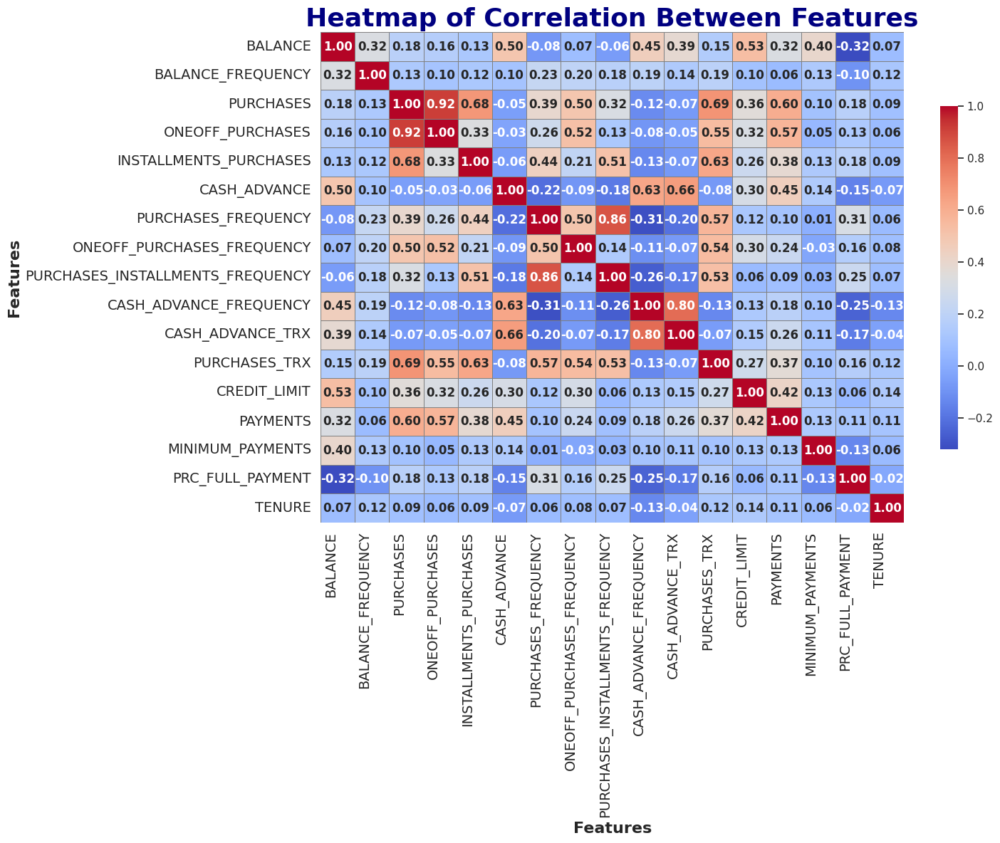

In [20]:
plt.figure(figsize=(15, 12))
sns.set(style='whitegrid')

# Create the heatmap
sns.heatmap(
    Data.corr(), 
    annot=True, 
    fmt=".2f", 
    cmap='coolwarm', 
    linewidths=0.5, 
    linecolor='gray', 
    cbar_kws={'shrink': 0.7}, 
    annot_kws={"size": 12, "weight": "bold"}
)

plt.title('Heatmap of Correlation Between Features', fontsize=26, fontweight='bold', color='navy')
plt.xlabel('Features', fontsize=16, fontweight='bold')
plt.ylabel('Features', fontsize=16, fontweight='bold')
plt.xticks(fontsize=14, rotation=90, ha='right')
plt.yticks(fontsize=14)
plt.tight_layout()
plt.show()


<span style="color:#3498DB; font-size:1.4em; font-weight:bold;">📈 Correlation Insights:</span> 

The features exhibiting the highest correlation with the **"PURCHASES"** column include **"BALANCE"** and **"CASH_ADVANCE."** These columns significantly influence the purchasing behavior of customers, highlighting important relationships within the dataset.


# 

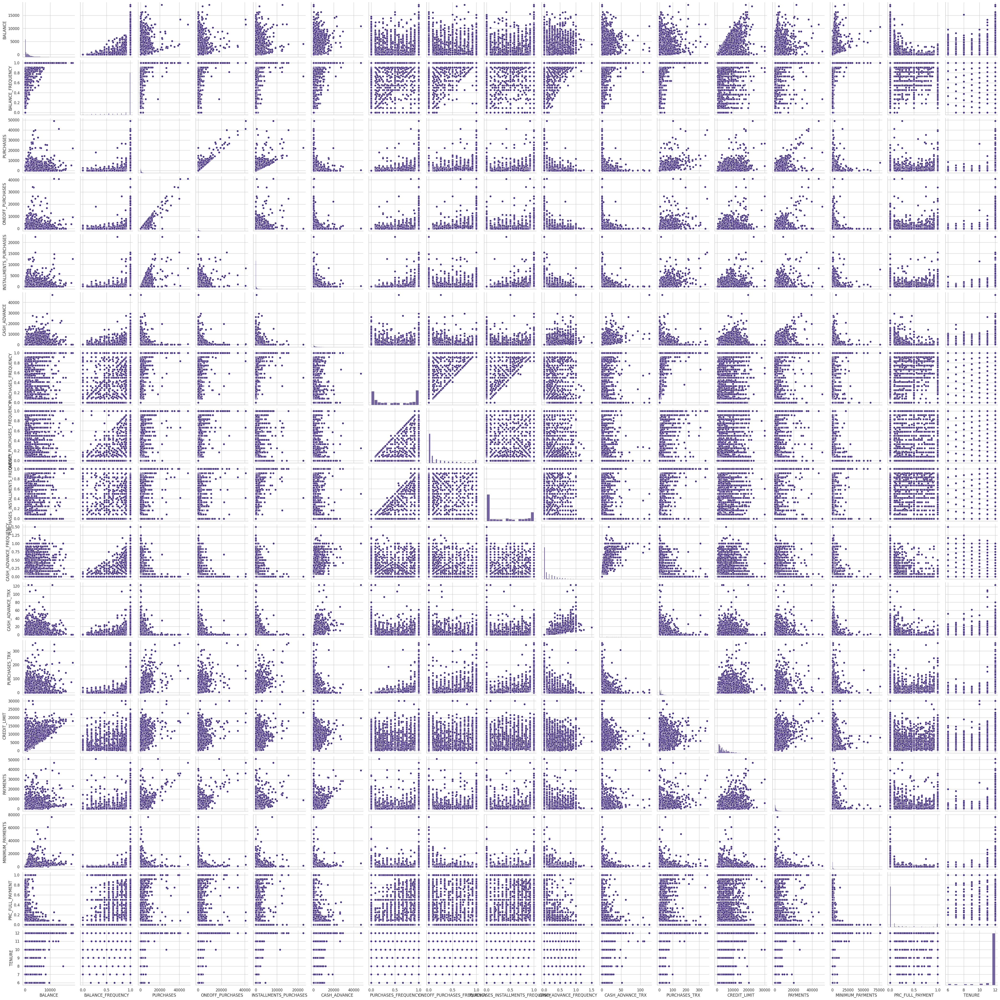

In [21]:
sns.set_palette("viridis")
sns.pairplot(Data)

<span style="color:#2E86C1; font-size:1.6em; font-weight:bold;">🔍 Noteworthy Relationships in the Data:</span>

1. <span style="color:#3498DB; font-weight:bold;">Linear Relationships in Purchases:</span>
   - A clear linear relationship is observed among **purchases**, **one-off purchases**, and **installment purchases**. As one increases, the others tend to rise in tandem, indicating correlated consumer spending behaviors.

2. <span style="color:#3498DB; font-weight:bold;">Credit Limit and Balance:</span>
   - An increase in the **credit limit** corresponds with a rise in the **credit balance**. This linear relationship suggests that consumers are likely to utilize their increased credit capacity, leading to higher outstanding balances.

3. <span style="color:#3498DB; font-weight:bold;">Impact of Purchases on Cash Advances:</span>
   - A noteworthy finding indicates that an increase in the number of **purchases** is associated with a decrease in **cash advance** transactions. This inverse relationship suggests that customers actively making purchases may rely less on cash advances.

4. <span style="color:#3498DB; font-weight:bold;">Low Credit Balances:</span>
   - When **credit balances** are low, there is a notable decrease in the volume of **purchases**, **one-off purchases**, and **installment purchases**. This supports findings from the univariate analysis, indicating that lower credit availability constrains consumer spending.

5. <span style="color:#3498DB; font-weight:bold;">Cash Advances and Credit Balances:</span>
   - Lower credit balances are also correlated with fewer **cash advance** transactions, suggesting that consumers are less likely to utilize cash advances when they have limited credit available.

6. <span style="color:#3498DB; font-weight:bold;">Lack of Relationships in Other Features:</span>
   - In contrast, the remaining features in the dataset do not exhibit any significant relationships that warrant further analysis, indicating a lack of correlation or interaction among them.


# 

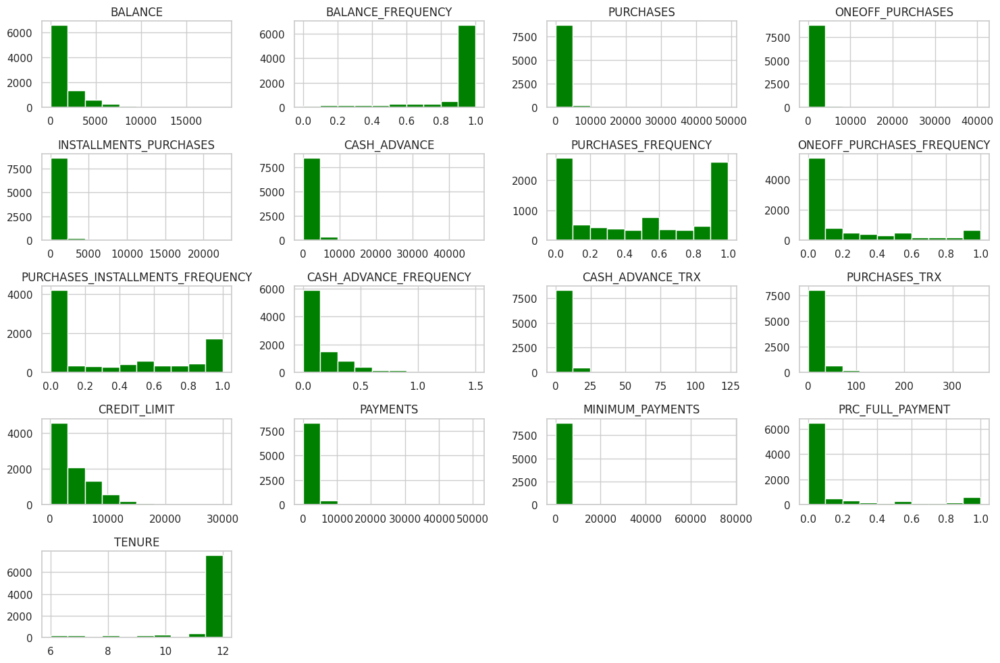

In [22]:
Data.hist(figsize=(15, 10), color='green')
plt.tight_layout()
plt.show()

<span style="color:#2E86C1; font-size:1.6em; font-weight:bold;">📊 Analysis of Histograms</span>

1. <span style="color:#3498DB; font-weight:bold;">Balance:</span>
   - It appears that most customers have low balances, indicating that very few carry high balances. This left skew suggests that many are likely using their credit conservatively.

2. <span style="color:#3498DB; font-weight:bold;">Balance Frequency:</span>
   - Similar to balances, the frequency of balances also skews left. Most customers have low balance frequencies, indicating infrequent use of their credit accounts.

3. <span style="color:#3498DB; font-weight:bold;">Purchases:</span>
   - The purchases histogram reveals that most customers make smaller purchases. As we move to the right, the number of customers making larger purchases declines significantly.

4. <span style="color:#3498DB; font-weight:bold;">One-Off Purchases:</span>
   - Like general purchases, one-off purchases are heavily left-skewed, suggesting that many customers don’t often make large, infrequent purchases.

5. <span style="color:#3498DB; font-weight:bold;">Installments Purchases:</span>
   - This shows that most customers make very few installment purchases, indicating a preference for paying in full rather than through installments.

6. <span style="color:#3498DB; font-weight:bold;">Cash Advance:</span>
   - The cash advance distribution also skews to the left, meaning most customers either take out very little or no cash advance at all.

7. <span style="color:#3498DB; font-weight:bold;">Purchases Frequency:</span>
   - The frequency of purchases reveals that most customers do not buy things often, indicating a more cautious approach to spending.

8. <span style="color:#3498DB; font-weight:bold;">Cash Advance Frequency:</span>
   - This shows that most customers rarely take cash advances, highlighting that cash advances are not common behavior among them.

9. <span style="color:#3498DB; font-weight:bold;">Credit Limit:</span>
   - The credit limits are skewed left, indicating that many customers have relatively low limits set by their credit providers.

10. <span style="color:#3498DB; font-weight:bold;">Payments:</span>
    - Most customers appear to make lower payment amounts, suggesting they are using their credit lines conservatively.

11. <span style="color:#3498DB; font-weight:bold;">Minimum Payments:</span>
    - Many customers seem to meet their minimum payments, reflecting responsible credit behavior and management.

12. <span style="color:#3498DB; font-weight:bold;">Tenure:</span>
    - Most customers have a short credit history, as indicated by the concentration of values on the lower end of the tenure range.

<span style="color:#2E86C1; font-size:1.6em; font-weight:bold;">📋 Summary</span>
In summary, these histograms indicate that the majority of customers operate at lower levels of credit usage. Most have low balances and make fewer, smaller purchases, suggesting a cautious approach to spending. This information could be instrumental in understanding various customer behaviors and tailoring credit strategies accordingly.


# 

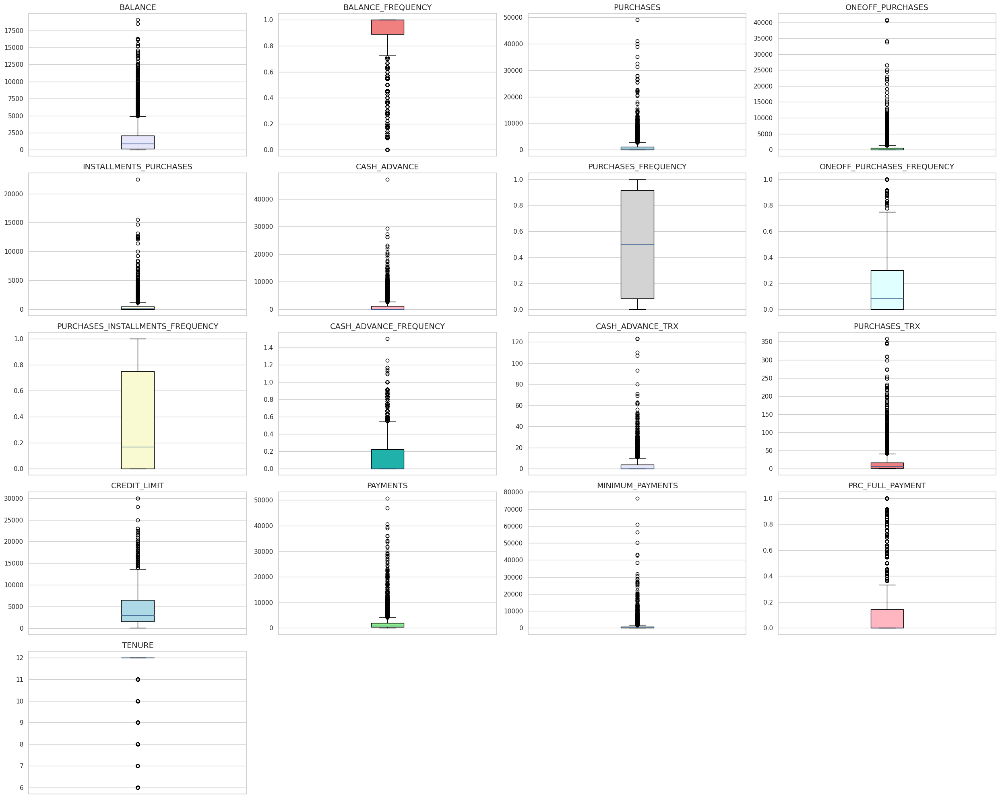

In [23]:
plt.figure(figsize=(25, 20))  
colors = ['lavender', 'lightcoral', 'lightblue', 'lightgreen', 'lightyellow', 
          'lightpink', 'lightgray', 'lightcyan', 'lightgoldenrodyellow', 'lightseagreen']

for index, column in enumerate(Data.columns):
    plt.subplot(5, 4, index + 1) 
    plt.boxplot(Data[column], patch_artist=True, 
                boxprops=dict(facecolor=colors[index % len(colors)]))  
    plt.title(column, fontsize=14)  
    plt.xticks([])  

plt.tight_layout()  
plt.show()

<span style="color:#27AE60; font-size:1.5em; font-weight:bold;">📈 Chart Analysis</span>  

#### 📊 Distribution and Median Values:
- **💰 BALANCE:** The median is around **$1,000**, but the box (the interquartile range) is very narrow, indicating that most customers have relatively low debts.
- **🛍️ PURCHASES:** The median is approximately **$2,000**, with high outliers indicating customers with significantly higher spending.

#### 📦 Box Sizes:
The sizes of the boxes indicate significant differences in data distribution. For **💳 CREDIT_LIMIT**, the larger box shows a wide range of credit available to different customers.

#### 📉 Outliers:
Points that lie outside the horizontal lines (whiskers) can indicate outliers. For example, in **💵 CASH_ADVANCE** and **💰 PAYMENTS**, the outliers suggest customers with very high cash withdrawals or payments.

#### 🔍 Specific Features:
- **🔄 BALANCE_FREQUENCY:** This feature indicates how frequently the balance is updated. Values close to **1** suggest regular updates.
- **📆 INSTALLMENTS_PURCHASES:** Most customers do not have installment purchases, as the median and box for this feature are close to **zero**.
- **📊 PURCHASES_FREQUENCY:** This feature reflects the frequency of customer purchases, with the box in the middle indicating typical purchasing behavior among customers.


<span style="color:#2E86C1; font-size:1.6em; font-weight:bold;">📈 Data Distribution Analysis</span>

#### In these plots, the distribution of the data is visualized, and as observed, the column <span style="color:#3498DB; font-weight:bold;">CASH_ADVANCE_TRX</span> exhibits a uniform distribution.


# 

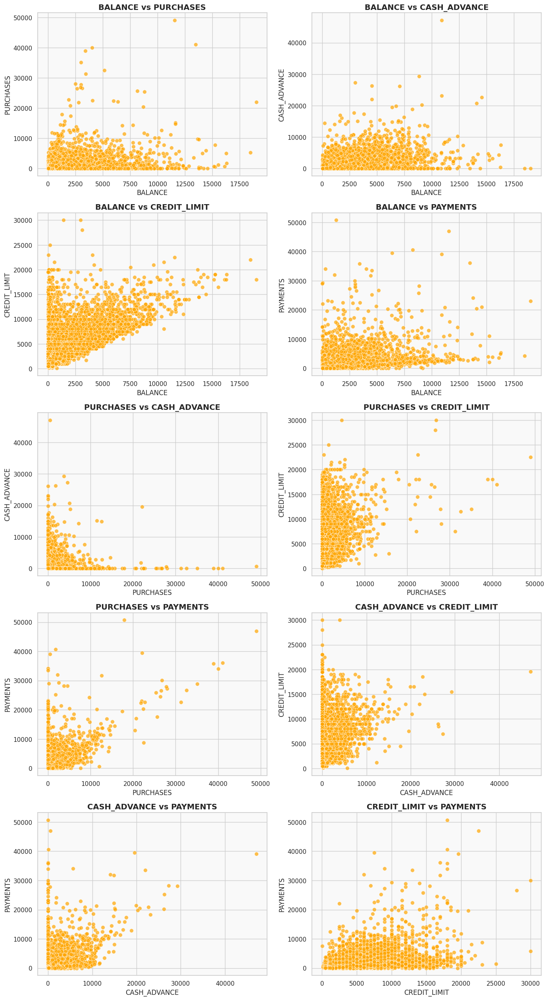

In [24]:
columns_to_plot = ['BALANCE', 'PURCHASES', 'CASH_ADVANCE', 'CREDIT_LIMIT', 'PAYMENTS']

num_plots = len(columns_to_plot)
nrows = (num_plots * (num_plots - 1)) // 2  
ncols = 2  

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(14, nrows * 5))
axs = axs.flatten() 

count = 0

for i in range(len(columns_to_plot)):
    for j in range(i + 1, len(columns_to_plot)):
        sns.scatterplot(x=Data[columns_to_plot[i]], y=Data[columns_to_plot[j]], 
                        ax=axs[count], color='orange', s=50, edgecolor='w', alpha=0.7)

        axs[count].set_title(f'{columns_to_plot[i]} vs {columns_to_plot[j]}', fontsize=14, fontweight='bold') 
        axs[count].set_xlabel(columns_to_plot[i], fontsize=12)  
        axs[count].set_ylabel(columns_to_plot[j], fontsize=12)  
        axs[count].grid(True) 
        axs[count].set_facecolor('#f9f9f9') 

        count += 1

for k in range(count, len(axs)):
    fig.delaxes(axs[k])

plt.tight_layout()  
plt.show() 

<span style="color:#27AE60; font-size:1.3em; font-weight:bold;"> 📊Analysis of Scatter Plots</span>

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Overall Trends:</span>  
Each plot shows how different financial variables interact with each other.

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">'BALANCE' Relationships:</span>  
- **BALANCE vs. PURCHASES**: There's a weak positive correlation here; as balances increase, so do purchases, but most purchases cluster around lower balances.  
- **BALANCE vs. CASH_ADVANCE**: Similar to purchases, there's a hint of a positive relationship, though it's not very strong.  
- **BALANCE vs. CREDIT_LIMIT**: This one shows a strong positive correlation, as higher balances usually come with higher credit limits.  
- **BALANCE vs. PAYMENTS**: This plot suggests a potential negative correlation; as balances rise, payments don’t necessarily keep pace.

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Relationships Among Other Variables:</span>  
- **PURCHASES vs. CASH_ADVANCE**: There’s a weak positive correlation, indicating that more purchases might lead to more cash advances.  
- **PURCHASES vs. CREDIT_LIMIT**: This shows a moderate positive correlation; higher credit limits generally lead to more purchases.  
- **PURCHASES vs. PAYMENTS**: A positive correlation is visible, suggesting that more purchases correlate with higher payments.  
- **CASH_ADVANCE vs. CREDIT_LIMIT**: This one shows a weak positive correlation; higher credit limits might mean more cash advances.  
- **CASH_ADVANCE vs. PAYMENTS**: There’s no clear correlation here; higher cash advances don’t consistently lead to higher payments.  
- **CREDIT_LIMIT vs. PAYMENTS**: This plot indicates a positive relationship, where higher credit limits often align with increased payments.

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Patterns and Anomalies:</span>  
- **Outliers**: Some data points stand out as outliers, particularly among higher purchases and balances, which might need further investigation.  
- **Non-linear Relationships**: A few plots suggest non-linear trends, hinting that the relationships could be more complex.

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Conclusion:</span>  
These scatter plots help us see trends and interactions between financial metrics, which can inform customer behavior predictions and credit decisions. To deepen the analysis, I might calculate correlation coefficients or run regression analyses and look more closely at the outliers.

<div style="width: 100%; height: 5px; background-color: #27AE60; margin: 10px 0;"></div>


# 

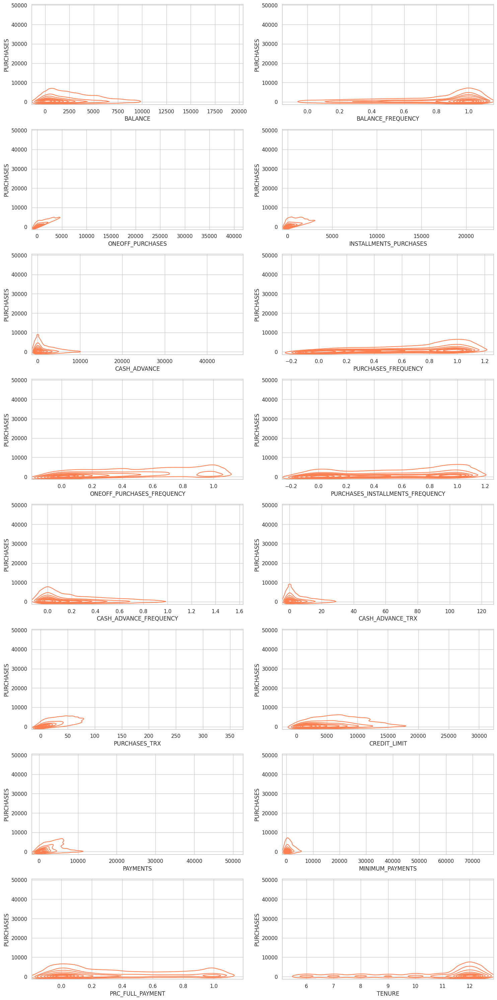

In [25]:
fig, axs = plt.subplots(nrows=8, ncols=2, figsize=(15, 30))
axs = axs.flatten()

for i, col in enumerate(Data.drop(columns='PURCHASES').columns):
    sns.kdeplot(x=col, y='PURCHASES', data=Data, ax=axs[i], color='coral')

fig.tight_layout()  
plt.show()

<span style="color:#27AE60; font-size:1.3em; font-weight:bold;">📊 Data Distribution Analysis:</span>

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">🔍 Identifying Density and Patterns:</span>  
In each plot, you can observe areas of higher density, which indicate the most frequent values across both variables. The regions with higher density reflect the concentration of repeated values in both the selected variable and **'PURCHASES'**.

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">✨ Potential Relationships Between Variables:</span>  
If the data distribution in a variable closely aligns with **'PURCHASES'** (for example, sharp or wide curves), this could indicate a strong correlation between that variable and **'PURCHASES'**.


# 

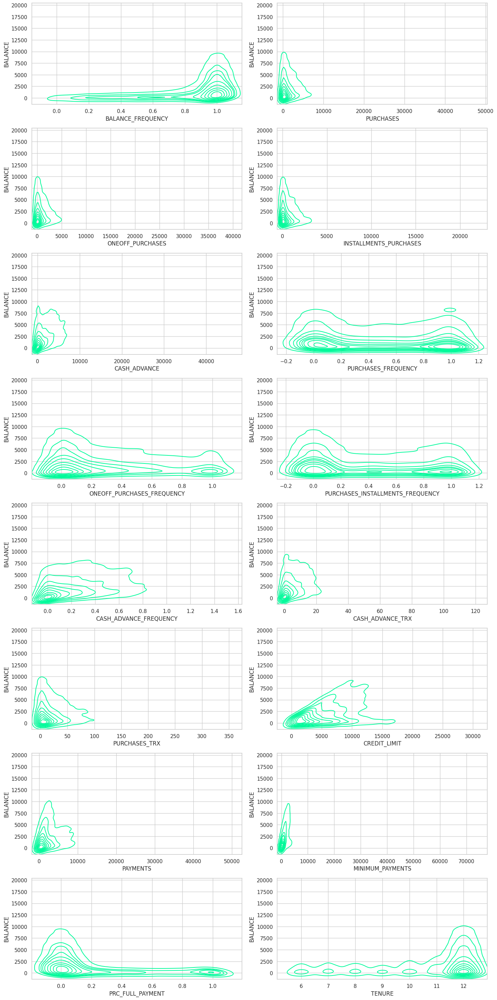

In [26]:
fig, axs = plt.subplots(nrows=8, ncols=2, figsize=(15, 30))
axs = axs.flatten()

for i, col in enumerate(Data.drop(columns='BALANCE').columns):
    sns.kdeplot(x=col, y='BALANCE', data=Data, ax=axs[i], color='mediumspringgreen')

fig.tight_layout()  
plt.show()

<span style="color:#27AE60; font-size:1.3em; font-weight:bold;">♻️ KDE Plots Analysis with Focus on 'BALANCE':</span>

This set of plots shows the distribution of different variables against the **'BALANCE'** column using Kernel Density Estimation (KDE). Each plot illustrates how the selected variables relate to **'BALANCE.'** The analysis of these plots helps in identifying patterns and possible relationships between **'BALANCE'** and other variables.

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">✨ Identifying Density and Patterns:</span>  
In each plot, the areas with darker shades indicate where the data is more concentrated. These high-density areas represent the most frequent values for both **'BALANCE'** and the compared variable.

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">🔍 Possible Relationships Between Variables:</span>  
**Alignment of Distributions:** If the distribution of a variable closely follows **'BALANCE'** with similar patterns of density, it may suggest a strong relationship between the two.  
**Different Distributions:** Some plots may show distinct patterns, indicating a weaker relationship or even non-linear interactions between **'BALANCE'** and that variable.

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">🎯 Identifying High and Low-Density Areas:</span>  
**High-Density Areas:** These indicate ranges where many values occur frequently. For example, if a large portion of the data clusters around a specific **'BALANCE'** value, it highlights the significance of that range.  
**Low-Density Areas:** These are regions where fewer values appear, potentially containing outliers or rare occurrences.

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">📊 Analysis of Density Differences:</span>  
**Asymmetric Distribution:** Some plots may show uneven distributions, pointing to large differences between **'BALANCE'** and the other variable in certain ranges.  
**Width of the Curves:** Wider curves suggest more variation in the data, while narrower curves indicate a higher concentration of values around specific points.


# 

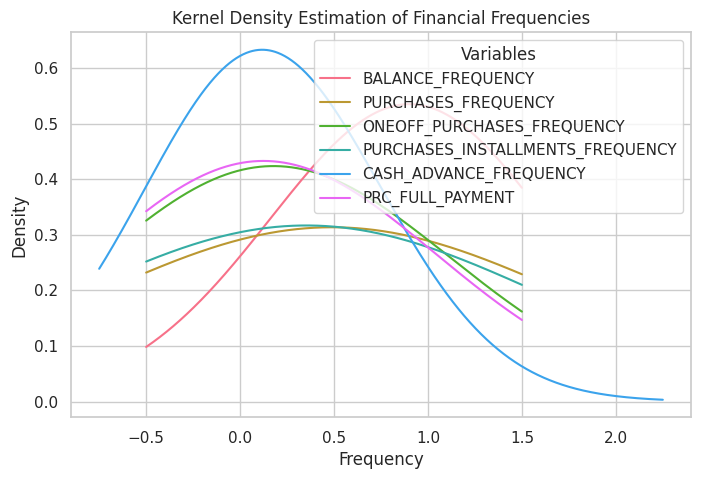

In [27]:
colors = sns.color_palette("husl", n_colors=6)  

ax = Data[['BALANCE_FREQUENCY', 'PURCHASES_FREQUENCY',
            'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
            'CASH_ADVANCE_FREQUENCY', 'PRC_FULL_PAYMENT']].plot.kde(
                figsize=(8, 5), bw_method=3, color=colors
            )

plt.title('Kernel Density Estimation of Financial Frequencies')
plt.xlabel('Frequency')
plt.ylabel('Density')
plt.legend(title='Variables')
plt.show()


#### <span style="color:#27AE60;  font-size:1.3em; font-weight:bold;">📊 Probability Density Estimation</span>  
This plot generates probability density estimation, indicating how data points are distributed along the scale of these features. It illustrates the frequency counts of the specified columns and how the data is distributed across the range of these features. <span style="color:#F39C12;">🌐</span>


# 

### <span style="color:#2980B9; font-size:1.8em; font-weight:bold;">⚙️ Create Model</span>


In [28]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

<span style="color:#8E44AD; font-size:1.5em; font-weight:bold;">Normalize</span>

In [29]:
scaler = StandardScaler()
scaled_features = scaler.fit_transform(Data)
scaled_Data = pd.DataFrame(scaler.fit_transform(Data), columns=Data.columns)
scaled_Data 

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,-0.732054,-0.249881,-0.424934,-0.356957,-0.349114,-0.466805,-0.806649,-0.678716,-0.707409,-0.675294,-0.476083,-0.511381,-0.960380,-0.529026,-0.299303,-0.525588,0.360541
1,0.786858,0.134049,-0.469584,-0.356957,-0.454607,2.605438,-1.221928,-0.678716,-0.917090,0.573949,0.110032,-0.591841,0.688601,0.818546,0.100137,0.234159,0.360541
2,0.447041,0.517980,-0.107716,0.108843,-0.454607,-0.466805,1.269742,2.673295,-0.917090,-0.675294,-0.476083,-0.109082,0.826016,-0.383857,-0.090437,-0.525588,0.360541
3,0.049015,-1.017743,0.231995,0.546123,-0.454607,-0.368678,-1.014290,-0.399383,-0.917090,-0.258882,-0.329554,-0.551611,0.826016,-0.598733,-0.359042,-0.525588,0.360541
4,-0.358849,0.517980,-0.462095,-0.347317,-0.454607,-0.466805,-1.014290,-0.399383,-0.917090,-0.675294,-0.476083,-0.551611,-0.905414,-0.364421,-0.254222,-0.525588,0.360541
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,-0.738015,0.517980,-0.333331,-0.356957,-0.132688,-0.466805,1.269742,-0.678716,1.179720,-0.675294,-0.476083,-0.350461,-0.960380,-0.486266,-0.338109,1.183844,-4.126919
8945,-0.742488,0.517980,-0.329174,-0.356957,-0.122869,-0.466805,1.269742,-0.678716,1.179720,-0.675294,-0.476083,-0.350461,-0.960380,-0.503445,-0.240917,-0.525588,-4.126919
8946,-0.740463,-0.185895,-0.402000,-0.356957,-0.294930,-0.466805,0.854463,-0.678716,0.760359,-0.675294,-0.476083,-0.390691,-0.960380,-0.570660,-0.323750,0.329128,-4.126919
8947,-0.745239,-0.185895,-0.469584,-0.356957,-0.454607,-0.449373,-1.221928,-0.678716,-0.917090,0.157536,-0.183026,-0.591841,-1.097795,-0.580581,-0.335167,0.329128,-4.126919


<span style="color:#2ECC71; font-size:1.5em; font-weight:bold;">Elbow Method</span>

In [30]:
kmeans_set={"init":"random","n_init":10,"max_iter":300,"random_state":42}

In [31]:
cluster_range = range( 1, 20 )
cluster_errors=[]
for k in cluster_range:
    kmeans= KMeans(n_clusters=k, **kmeans_set) #** open dictionry
    kmeans.fit(scaled_features)
    cluster_errors.append( kmeans.inertia_) 

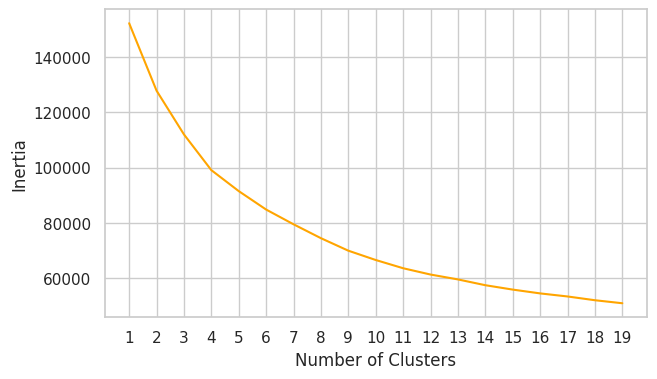

In [32]:
plt.figure(figsize=(7,4))  
plt.plot(range(1, 20), cluster_errors, color='orange') 
plt.xticks(range(1, 20))
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.show()

In [33]:
pip install yellowbrick

Note: you may need to restart the kernel to use updated packages.


In [34]:
# Now we are going to implement Elbow method to final optimal number of clusters
from kneed import KneeLocator
k1 = KneeLocator(range(1, 20), cluster_errors, curve='convex', direction='decreasing')
k1.elbow

6

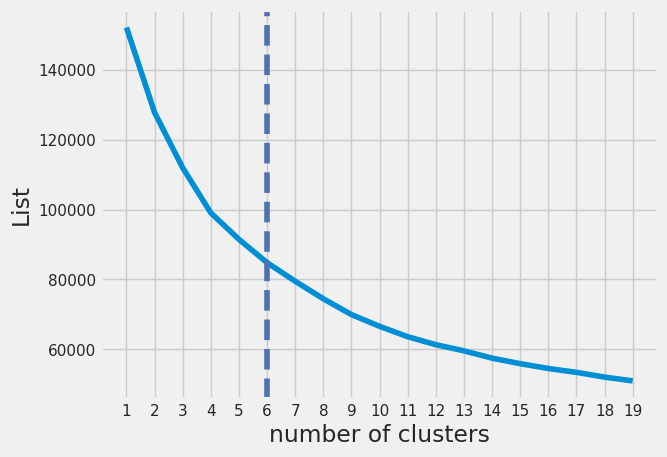

In [35]:
plt.style.use("fivethirtyeight")
plt.plot(range(1,20),cluster_errors)
plt.xticks(range(1,20))
plt.xlabel('number of clusters')
plt.ylabel('List')
plt.axvline(x=k1.elbow, color='b', label= 'axvline-full height', ls= '--')
plt.show()

 <span style="color:#8E44AD; font-size:1.3em; font-weight:bold;">Silhouette Coefficient Method</span>


In [36]:
from sklearn.metrics import silhouette_score

 <span style="color:#8E44AD; font-size:1.1em; font-weight:bold;">let's try silhouette_score for k=6,2,3 10 </span>


In [37]:
# Instantiate the KMeans for 6 clusters
km = KMeans(n_clusters=6, random_state=42)
# Fit the KMeans model
km.fit_predict(scaled_features)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, km.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.203


In [38]:
# Instantiate the KMeans for 2 clusters
km = KMeans(n_clusters=2, random_state=42)
# Fit the KMeans model
km.fit_predict(scaled_features)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, km.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.210


In [39]:
# Instantiate the KMeans for 3 clusters
km = KMeans(n_clusters=3, random_state=42)
# Fit the KMeans model
km.fit_predict(scaled_features)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, km.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.250


In [40]:
# Instantiate the KMeans for 10 clusters
km = KMeans(n_clusters=10, random_state=42)
# Fit the KMeans model
km.fit_predict(scaled_features)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, km.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.223


In [41]:
from sklearn.metrics import silhouette_score

# Instantiate the KMeans for 6 clusters
km = KMeans(n_clusters=6, random_state=42)
# Fit the KMeans model
km.fit_predict(scaled_features)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, km.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.203


<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">The best number of clusters for clustering is 3 for silhouette_score</span>


# 

In [42]:
silhouette_coefficients =[]
for k in range(2,20):#1 is the worse
    kmeans=KMeans(n_clusters=k, **kmeans_set)
    kmeans.fit(scaled_features)
    score= silhouette_score(scaled_features, kmeans.labels_)
    silhouette_coefficients.append(score)

In [43]:
silhouette_coefficients

[0.20947293351456914,
 0.2504207134550512,
 0.1975433531733017,
 0.1932527665313388,
 0.20288603945722414,
 0.21522453796064184,
 0.22185743051480203,
 0.22683180663837285,
 0.22115889469084257,
 0.21909408487497875,
 0.21739711288001562,
 0.20721572208247538,
 0.21909451913105038,
 0.22074978048423316,
 0.20162830696316453,
 0.20925022263435308,
 0.170501265799651,
 0.20492769716812204]

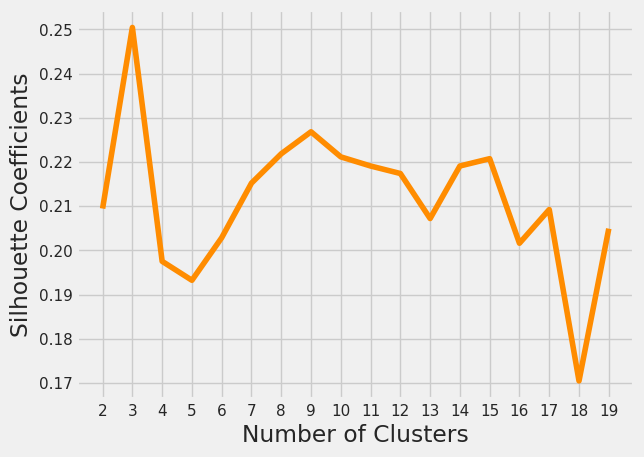

In [44]:
plt.style.use("fivethirtyeight")
plt.plot(range(2, 20), silhouette_coefficients, color='darkorange')
plt.xticks(range(2, 20))
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Coefficients')
plt.show()

<span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Highest silhouette score is k = 3.</span>


# 

In [45]:
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def evaluate_metrics(data, min_clusters=2, max_clusters=10, random_state=42):
    inertias = []
    silhouette_scores = []
    calinski_harabasz_scores = []
    davies_bouldin_scores = []
    
    for n_clusters in range(min_clusters, max_clusters):
        kmeans = KMeans(n_clusters=n_clusters, random_state=random_state)
        labels = kmeans.fit_predict(data)
        
        inertias.append(kmeans.inertia_)
        silhouette_scores.append(silhouette_score(data, labels))
        calinski_harabasz_scores.append(calinski_harabasz_score(data, labels))
        davies_bouldin_scores.append(davies_bouldin_score(data, labels))        
    
    fig, ax = plt.subplots(2, 2, figsize=(15, 10))
    
    ax[0][0].plot(range(min_clusters, max_clusters), inertias, '-x', linewidth=2)
    ax[0][0].set_xlabel('Number of Clusters')
    ax[0][0].set_ylabel('Inertia')
    
    ax[0][1].plot(range(min_clusters, max_clusters), silhouette_scores, '-x', linewidth=2)
    ax[0][1].set_xlabel('Number of Clusters')
    ax[0][1].set_ylabel('Silhouette Score')
    
    ax[1][0].plot(range(min_clusters, max_clusters), calinski_harabasz_scores, '-x', linewidth=2)
    ax[1][0].set_xlabel('Number of Clusters')
    ax[1][0].set_ylabel('Calinski-Harabasz Score')
    
    ax[1][1].plot(range(min_clusters, max_clusters), davies_bouldin_scores, '-x', linewidth=2)
    ax[1][1].set_xlabel('Number of Clusters')
    ax[1][1].set_ylabel('Davies-Bouldin Score')
    
    fig.suptitle('Evaluation Metrics for Clustering')
    plt.tight_layout()
    plt.show()


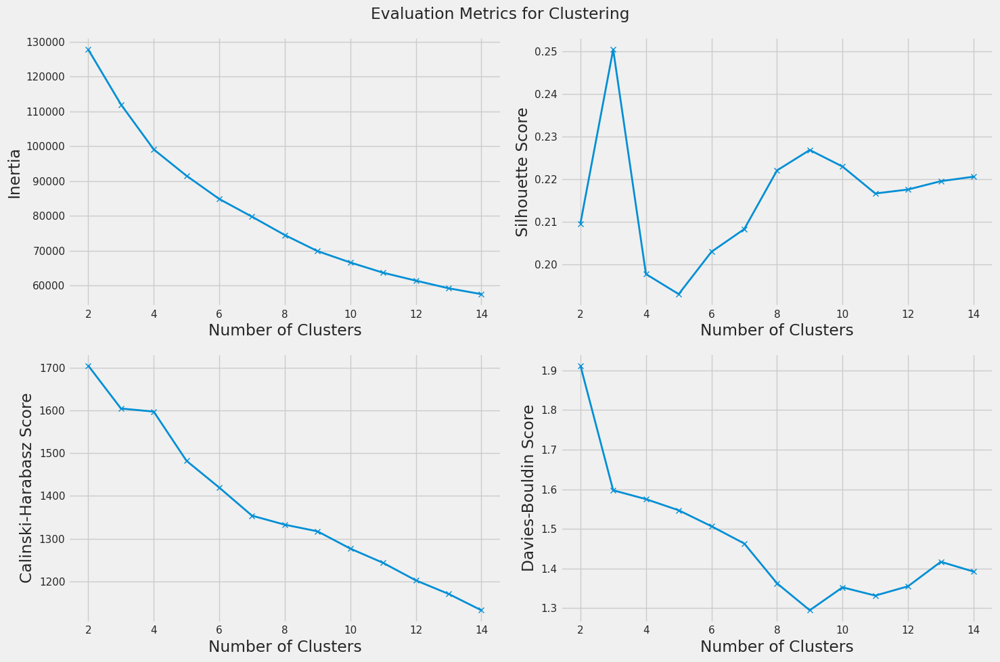

In [46]:
evaluate_metrics(scaled_features, min_clusters=2, max_clusters=15, random_state=42)


### 📊 1. Inertia Plot:
Inertia measures how tightly the clusters are packed. A lower inertia value indicates that the data points are closer to their respective cluster centers.

**Interpretation:**
- As the number of clusters increases, inertia generally decreases. This is because with more clusters, data points are assigned to more localized centers, reducing the distance to the centroid.
- You might look for a point where the decrease in inertia starts to level off. This point suggests an optimal number of clusters, often referred to as the "elbow" point.

---

### 📈 2. Silhouette Score Plot:
Silhouette Score quantifies how similar an object is to its own cluster compared to other clusters. The score ranges from -1 to +1, where a higher score indicates better-defined clusters.

**Interpretation:**
- As the number of clusters increases, you expect to see the silhouette score rise initially. This indicates that the clusters are becoming more distinct.
- A peak in this plot suggests an ideal number of clusters, as it indicates the best separation of the clusters.
- If the score is consistently low or negative, it indicates that clusters may be poorly defined or that data points might be placed in incorrect clusters.

---

### 📊 3. Calinski-Harabasz Score Plot:
Calinski-Harabasz Score (or Variance Ratio Criterion) measures the ratio of the sum of between-cluster dispersion to within-cluster dispersion. Higher values indicate better clustering.

**Interpretation:**
- Similar to the silhouette score, you want to look for a peak in this plot. This peak indicates an optimal number of clusters where the separation between clusters is maximized compared to the variance within clusters.

---

### 📉 4. Davies-Bouldin Score Plot:
Davies-Bouldin Score evaluates the average similarity ratio of each cluster with its most similar cluster. Lower scores indicate better clustering.

**Interpretation:**
- As the number of clusters increases, you expect the Davies-Bouldin score to decrease. This decrease indicates that clusters are becoming more distinct and separated from one another.
- A low score suggests well-separated and compact clusters.

---


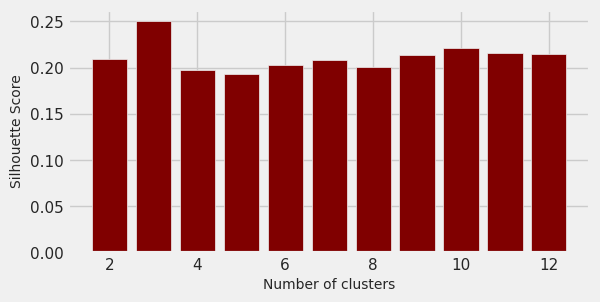

In [47]:
silhouette_scores = []

for n_cluster in range(2, 13):
    silhouette_scores.append( 
        silhouette_score(scaled_features, KMeans(n_clusters = n_cluster).fit_predict(scaled_features))) 
    
# Plotting a bar graph to compare the results 
k = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 

plt.figure(figsize=(6, 3))
plt.bar(k, silhouette_scores, color='maroon') 
plt.xlabel('Number of clusters', fontsize=10) 
plt.ylabel('Silhouette Score', fontsize=10) 
plt.show()

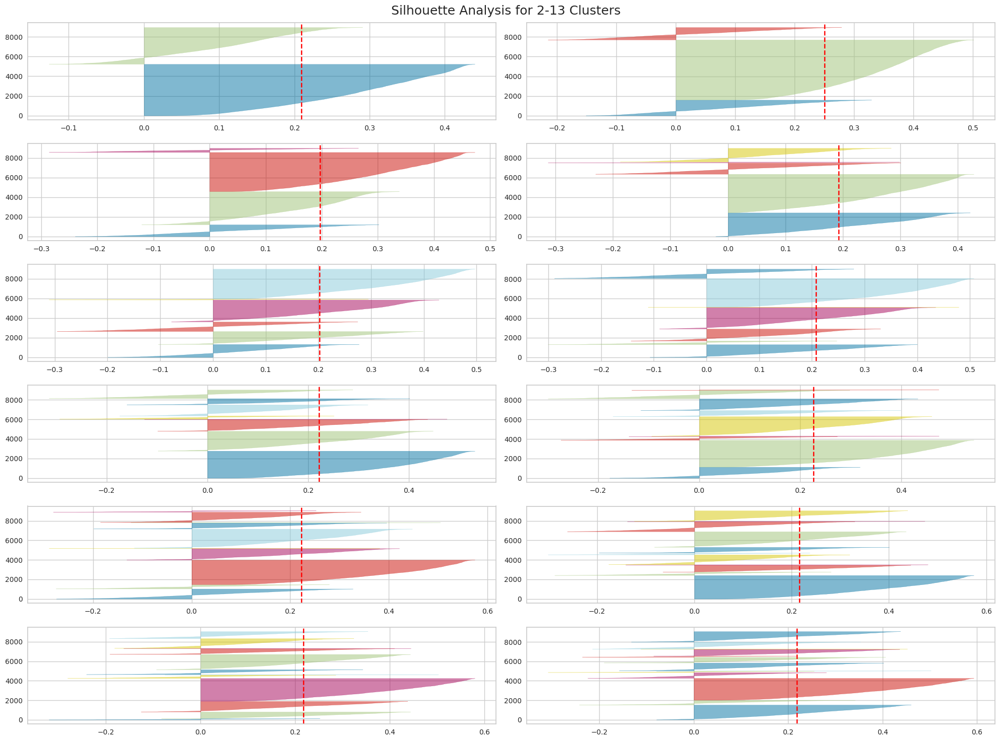

In [48]:
from yellowbrick.cluster import SilhouetteVisualizer
# Yellowbrick extends the Scikit-Learn API to make model selection and hyperparameter tuning easier.
# You can find the code to simply create Silhouette visualisation for K-Means clusters with n_cluster 
fig, ax = plt.subplots(6, 2, figsize=(20,15))
fig.suptitle('Silhouette Analysis for 2-13 Clusters', size = 18)
plt.tight_layout()

for i in [2, 3, 4, 5, 6, 7,8,9,10,11,12,13]:
    '''
    Create KMeans instance for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(scaled_features)

### 📊 Silhouette Analysis for Different Numbers of Clusters

Silhouette analysis helps evaluate the performance and quality of clustering, such as with a **K-means model**. The silhouette score indicates how well each data point fits within its assigned cluster compared to other clusters. A higher silhouette score suggests **better-defined clusters**.

---

#### How to Interpret the Chart:
- **X-axis**: Represents the silhouette score, which ranges from **-1 to +1**.
  - **Positive scores** (greater than 0) indicate that samples are well-clustered and belong to their respective clusters.
  - **Negative scores** suggest that samples might belong to a different cluster.
  
- **Y-axis**: Shows the number of data samples in each cluster.

- **Dashed red line**: Represents the average silhouette score for all clusters. The closer this line is to the right (towards higher scores), the better the overall clustering performance.

---

### 📊 Analysis of Each Subplot:
- **Smaller number of clusters** (e.g., **2 or 3 clusters**):
  - Clusters are **fairly well-separated**, and most silhouette scores are positive. This indicates that clustering with fewer clusters performs well.

- **Moderate number of clusters** (e.g., **5 to 10 clusters**):
  - As the number of clusters increases, some clusters show more **negative silhouette values**, especially for clusters with very narrow shapes. This suggests that some data points may not be assigned to the correct clusters, and cluster separation becomes less clear.

- **Larger number of clusters** (e.g., **more than 10 clusters**):
  - As the number of clusters grows, silhouette scores generally **decrease**, suggesting that **over-clustering** has occurred, and the data points are not well-defined within their respective clusters.

---

### 💡 Conclusion:
- **Clustering with fewer clusters** (such as **2 to 4**) performs better, as the silhouette values are **higher and more positive**, indicating well-separated clusters.
- As the number of clusters increases, the clustering quality declines, with more clusters showing **negative silhouette values**, meaning the data points do not fit well into their assigned clusters.


# 

<span style="color:#E74C3C; font-size:1.3em; font-weight:bold;">K-Means Algorithm</span>

In [49]:
# model with 3 clusters
kmeans_3=KMeans(n_clusters=3)
y_kmeans = kmeans_3.fit_predict(scaled_features)
y_kmeans

array([0, 1, 0, ..., 0, 0, 0], dtype=int32)

In [50]:
centriods = pd.DataFrame(data = kmeans.cluster_centers_, columns= [Data.columns])
centriods

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,-0.698659,-2.358175,-0.327555,-0.237718,-0.337537,-0.302943,-0.616821,-0.464384,-0.476110,-0.503042,-0.370188,-0.435751,-0.273185,-0.288101,-0.288976,-0.337159,0.178277
1,0.798189,0.315527,-0.275605,-0.165878,-0.346923,0.094759,-0.781311,-0.384270,-0.683465,-0.072620,-0.154549,-0.450505,1.023921,0.139374,0.159423,-0.442226,0.256116
2,0.110048,0.447607,1.079188,0.723289,1.221826,-0.331402,1.199273,1.401082,1.344588,-0.421366,-0.325531,1.727314,0.516030,0.440654,-0.059120,-0.175898,0.321178
3,-0.142562,0.407840,0.184066,0.390639,-0.281946,-0.341678,0.741796,1.739713,-0.404406,-0.410176,-0.331460,0.193590,-0.001066,-0.105864,-0.140955,-0.279251,0.255955
4,2.260691,0.480401,0.672796,0.403401,0.848814,0.680639,1.046778,0.724156,1.058511,0.769681,0.621640,1.048549,1.595132,0.607132,0.711641,-0.485399,0.303497
5,-0.725599,-1.618183,-0.255675,-0.229224,-0.183666,-0.400381,-0.317626,-0.383534,-0.276040,-0.589623,-0.419348,-0.354509,-0.091080,-0.166526,-0.299058,2.162641,0.169003
6,-0.235232,0.382200,-0.374537,-0.263566,-0.401357,-0.268449,-0.869637,-0.431389,-0.751769,-0.185113,-0.230082,-0.495448,-0.581906,-0.349458,-0.101448,-0.451984,0.274110
7,1.812915,0.005228,0.193915,0.215599,0.062468,6.041282,-0.263137,0.021154,-0.180462,1.908722,2.571712,-0.012531,1.825763,5.612799,0.616605,0.048165,0.072884
8,0.231877,0.366883,-0.387779,-0.278806,-0.404723,0.595556,-0.893485,-0.443499,-0.756764,1.529670,1.063372,-0.488921,-0.239783,-0.036817,-0.018371,-0.410776,0.147146
9,-0.303871,0.351748,-0.099122,-0.243771,0.213584,-0.342650,0.963554,-0.379848,1.175924,-0.419400,-0.331427,0.133597,-0.405689,-0.255174,-0.023665,-0.339703,0.278440


In [51]:
pd.Series(kmeans_3.labels_).value_counts()

0    6119
1    1595
2    1235
Name: count, dtype: int64

In [52]:
Data['kmeans_3']=kmeans_3.labels_

In [53]:
# Create a list of all the features
features = ['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES',
       'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE',
       'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY',
       'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY',
       'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS',
       'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE']

In [54]:
# Plot the average feature value for each cluster
describe = scaled_Data.groupby(Data['kmeans_3']).mean()
describe


,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
kmeans_3,,,,,,,,,,,,,,,,,
0.0,-0.264873,-0.118034,-0.178553,-0.156911,-0.133716,-0.198060,-0.073395,-0.176436,-0.060825,-0.194649,-0.169853,-0.187135,-0.255948,-0.206080,-0.087114,-0.005531,-0.033096
1.0,0.835824,0.233767,-0.216161,-0.160359,-0.216630,0.919185,-0.365624,-0.226814,-0.301687,0.972572,0.808684,-0.248361,0.426176,0.292495,0.242358,-0.280922,-0.049754
2.0,0.231016,0.282396,1.164074,0.984707,0.942556,-0.205705,0.836779,1.167518,0.691690,-0.292276,-0.203077,1.248276,0.717074,0.643217,0.118020,0.390635,0.227916


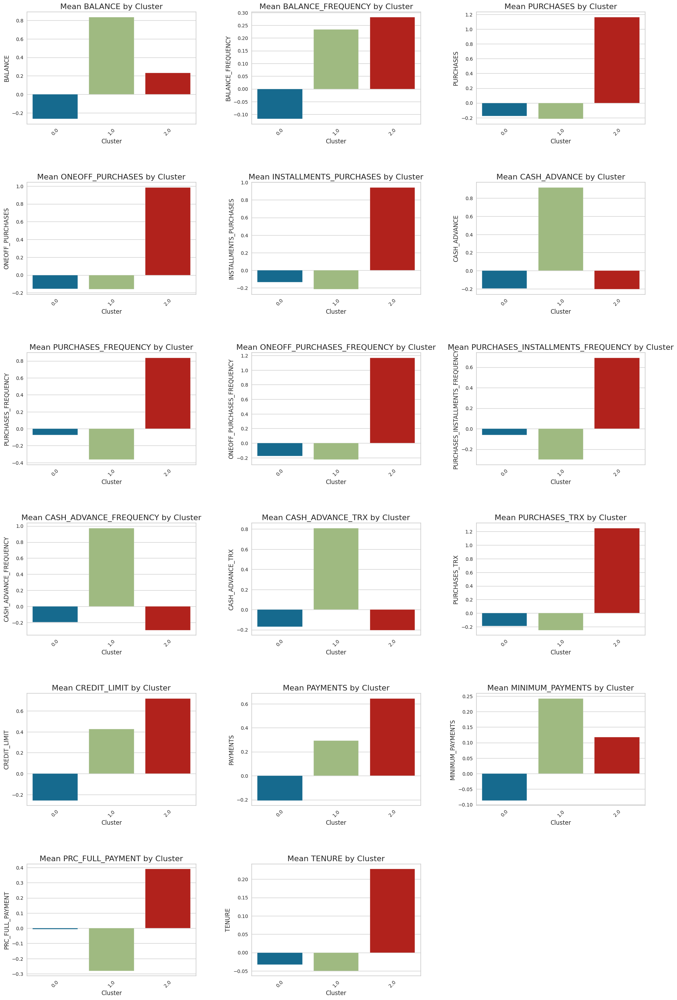

In [55]:
num_features = len(features)

fig, axes = plt.subplots(nrows=6, ncols=3, figsize=(20, 30))  

for idx, i in enumerate(features):
    row = idx // 3
    col = idx % 3
    sns.barplot(x=describe.index, y=i, data=describe, ax=axes[row, col])
    
    axes[row, col].set_title('Mean ' + str(i) + ' by Cluster', fontsize=16)  
    axes[row, col].set_xlabel('Cluster', fontsize=12) 
    axes[row, col].set_ylabel(i, fontsize=12) 
    axes[row, col].tick_params(axis='x', rotation=45, labelsize=10)  
    axes[row, col].tick_params(axis='y', labelsize=10)

if num_features % 3 != 0:
    for j in range(num_features, 18):  
        fig.delaxes(axes.flat[j])

plt.tight_layout(pad=5)

plt.show()


### 🎨✨ <span style="color:#27AE60;">Analysis of Features Across Clusters</span>

In these visualizations, we observe the **mean values** of each feature across different clusters. Each bar plot reveals how clusters vary in terms of specific characteristics, providing insightful information about **customer behavior patterns**.

---

#### 🔍 <span style="color:#E74C3C;">Cluster Differences:</span>
Some clusters exhibit noticeably **higher or lower mean values** for certain features, highlighting the distinct behaviors within each cluster. This variation is crucial in understanding the **unique traits** of each group.

---

#### 📊 <span style="color:#E74C3C;">Significance of Features:</span>
By examining the features that show the **greatest differences** between clusters, we can identify **key attributes** that distinguish one group from another. These significant features might represent **customer groups with unique purchasing habits** or **transaction patterns**.

---

#### 📈📉 <span style="color:#E74C3C;">Highs and Lows in Clusters:</span>
For features where certain clusters show much **higher or lower values** compared to others, we can gather useful insights into the **dominant characteristics** of that cluster. For instance, clusters with higher values for specific features may indicate **high-value customers** or **frequent buyers**.

---

#### 🎯 <span style="color:#E74C3C;">Identifiable Patterns:</span>
These plots help us spot **patterns** that might not be immediately apparent from raw data. For example, we can identify if a particular cluster consistently scores **higher across multiple features**, suggesting that this group has distinct **behavioral traits**.


# 

In [56]:
Data.describe(include="all")

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,kmeans_3
count,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000
mean,1564.647593,0.877350,1003.316936,592.503572,411.113579,978.959616,0.490405,0.202480,0.364478,0.135141,3.249078,14.711476,4494.449450,1733.336511,838.486229,0.153732,11.517935,0.454241
std,2081.584016,0.236798,2136.727848,1659.968851,904.378205,2097.264344,0.401360,0.298345,0.397451,0.200132,6.824987,24.858552,3638.815725,2895.168146,2335.473910,0.292511,1.337134,0.723860
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.000000,0.000000,6.000000,0.000000
25%,128.365782,0.888889,39.800000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.282850,164.391437,0.000000,12.000000,0.000000
50%,873.680279,1.000000,361.490000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,857.062706,295.779348,0.000000,12.000000,0.000000
75%,2054.372848,1.000000,1110.170000,577.830000,468.650000,1113.868654,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.279320,794.656428,0.142857,12.000000,1.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000,2.000000


In [57]:
Data.head(15)

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,kmeans_3
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,0.000000,0.000000,12,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0
5,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.0,1400.057770,2407.246035,0.000000,12,0
6,627.260806,1.000000,7091.01,6402.63,688.38,0.000000,1.000000,1.000000,1.000000,0.000000,0,64,13500.0,6354.314328,198.065894,1.000000,12,2
7,1823.652743,1.000000,436.20,0.00,436.20,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2300.0,679.065082,532.033990,0.000000,12,0
8,1014.926473,1.000000,861.49,661.49,200.00,0.000000,0.333333,0.083333,0.250000,0.000000,0,5,7000.0,688.278568,311.963409,0.000000,12,0
9,152.225975,0.545455,1281.60,1281.60,0.00,0.000000,0.166667,0.166667,0.000000,0.000000,0,3,11000.0,1164.770591,100.302262,0.000000,12,0


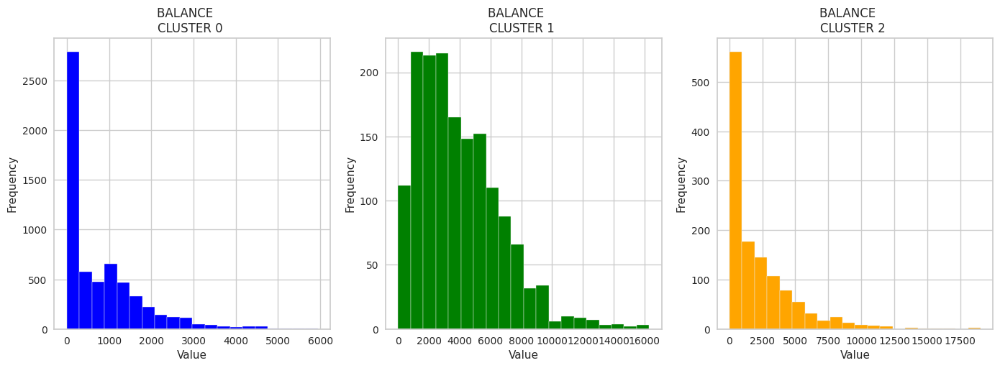

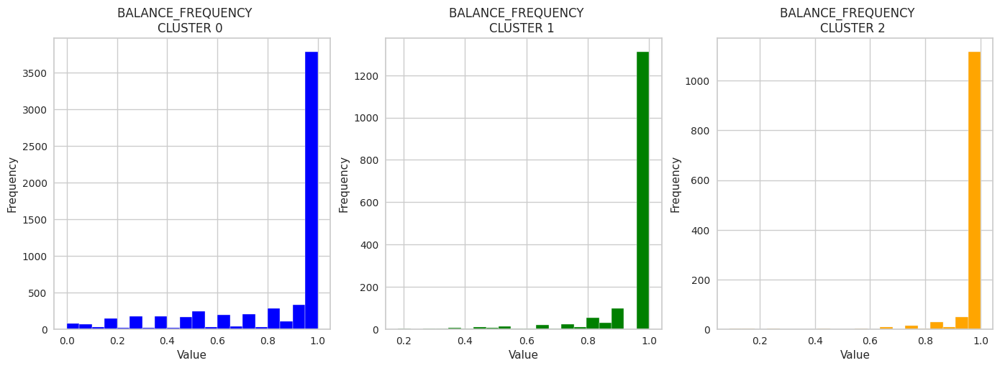

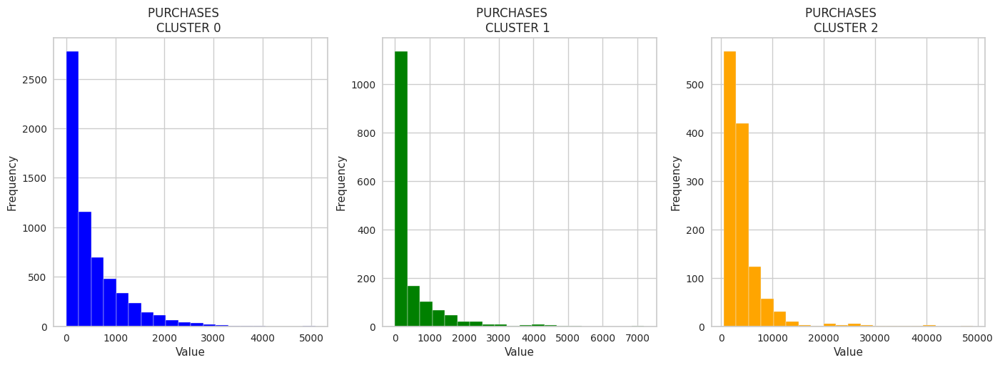

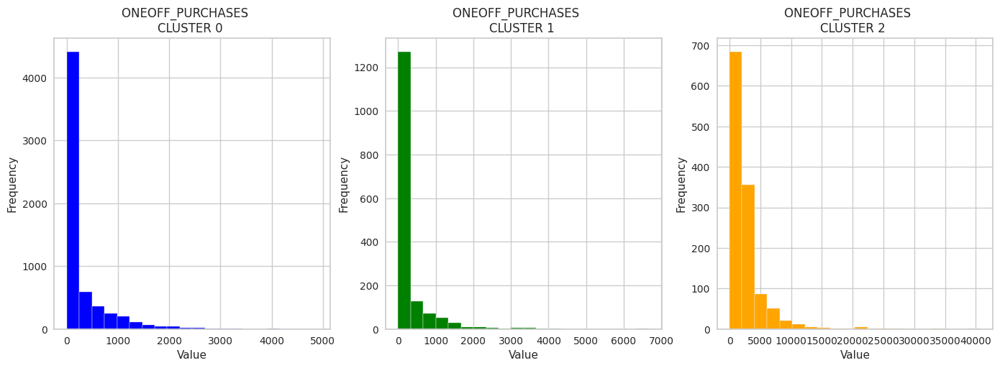

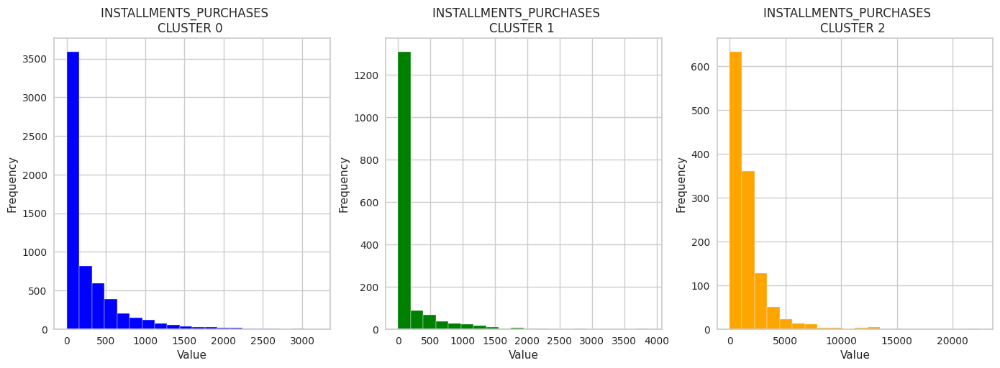

...

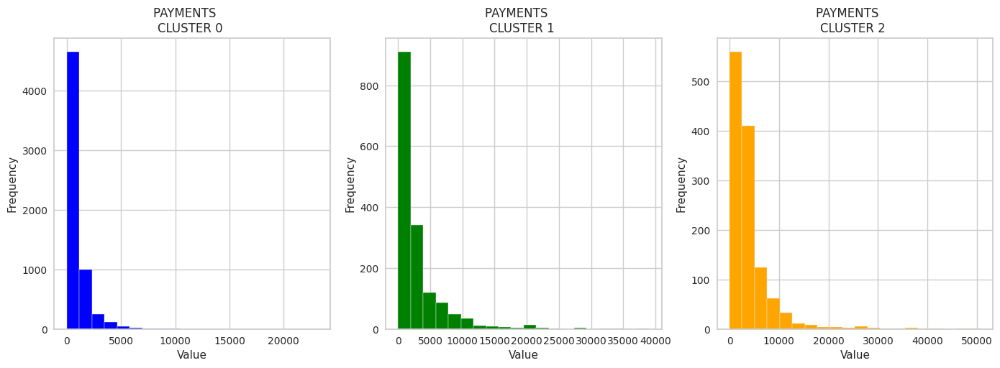

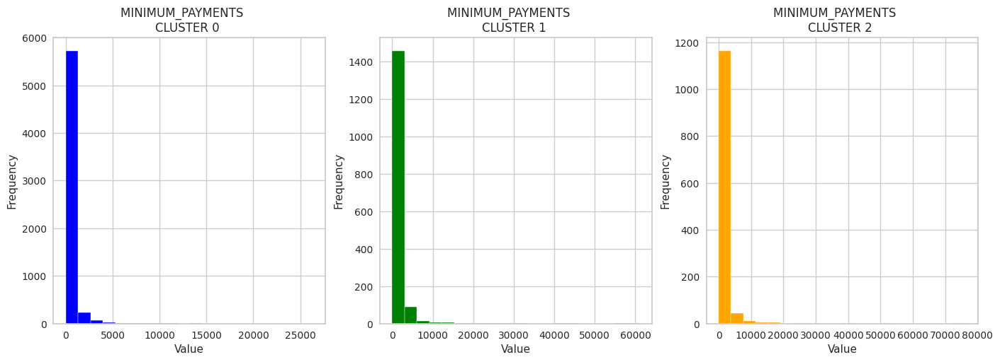

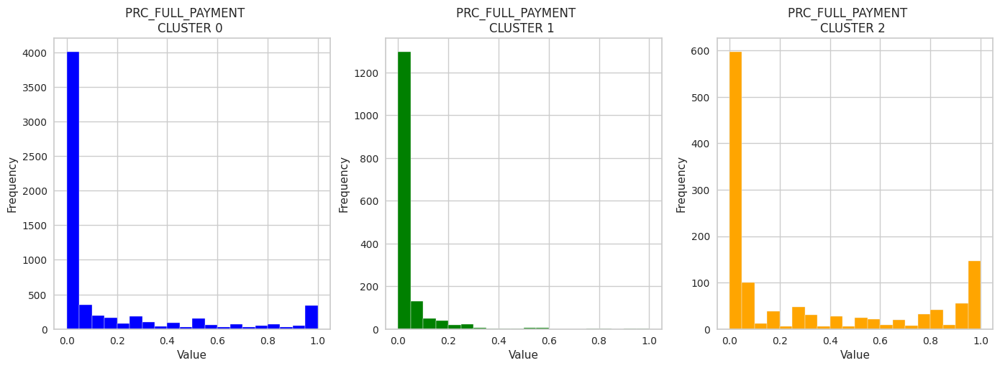

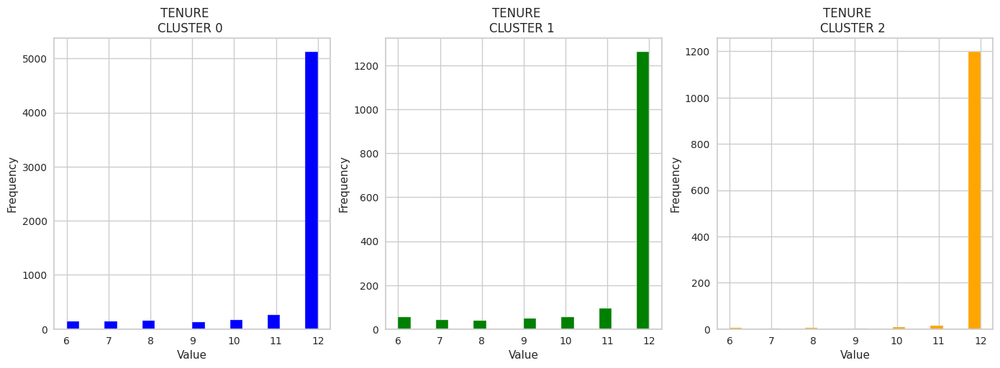

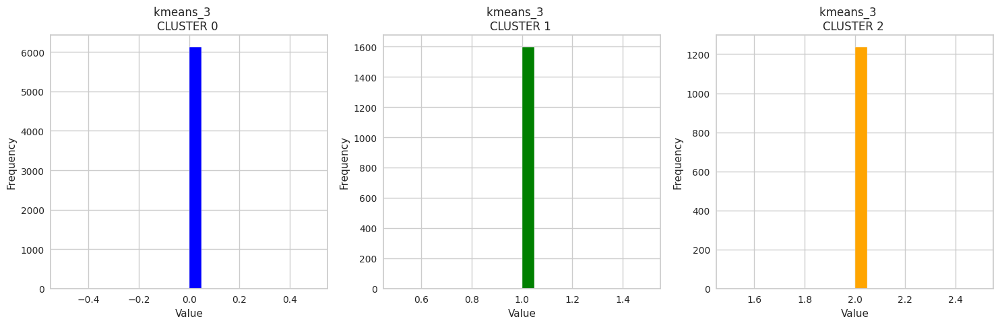

In [58]:
colors = ['blue', 'green', 'orange']

# Plot the histogram of various clusters
for i in Data.columns:
    plt.figure(figsize=(15, 5))  
    for j in range(3):
        plt.subplot(1, 3, j+1)
        ax = Data[Data['kmeans_3'] == j]
        ax[i].hist(bins=20, color=colors[j])
        plt.title('{}    \nCLUSTER {} '.format(i, j))
        plt.xlabel('Value')
        plt.ylabel('Frequency')
        plt.grid(True)  
         
plt.tight_layout()  
plt.show()


<span style="color:#E74C3C; font-size:1.5em; font-weight:bold;">Analysis of Histograms Across Clusters 📊</span>

In the following histograms, we visualize the distribution of values for various features across three distinct clusters generated by K-means clustering. Each cluster is represented by a different color, allowing us to easily identify differences in feature distributions.

<span style="color:#3498DB; font-weight:bold;">📈 Feature Distributions:</span>  
Each histogram displays the frequency of values for a specific feature within each cluster. By comparing the shapes and spread of these distributions, we can gain insights into how each cluster behaves concerning that feature.

<span style="color:#2ECC71; font-weight:bold;">🔍 Cluster Characteristics:</span>  
<span style="color:#3498DB; font-weight:bold;">Cluster 0 (Blue):</span> The histogram reveals the specific value range where most data points in this cluster are concentrated. A wider spread suggests diversity in behaviors, while a narrower range indicates uniformity.  
<span style="color:#2ECC71; font-weight:bold;">Cluster 1 (Green):</span> This cluster may show distinct peaks, indicating common values among its members. Observing how this distribution differs from the other clusters can help identify unique traits of this group.  
<span style="color:#E67E22; font-weight:bold;">Cluster 2 (Orange):</span> If this cluster's histogram displays a skewed distribution, it may suggest that most members of this cluster have either high or low values for the feature in question, differentiating them from the other clusters.


# 

In [59]:
Data.columns

Index(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE', 'kmeans_3'],
      dtype='object')

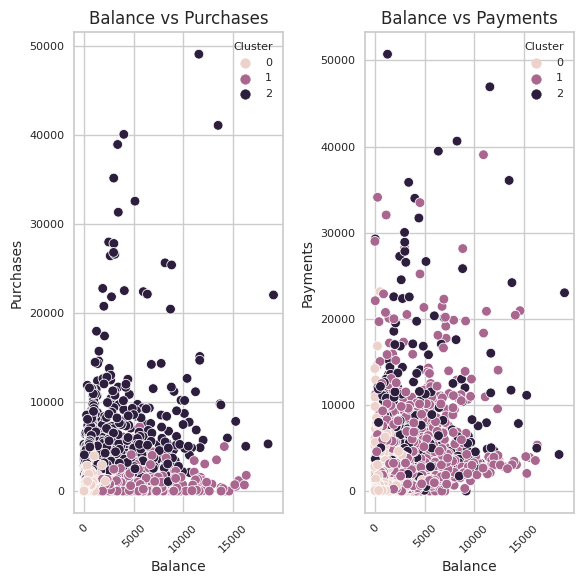

In [60]:
new_palette = ['royalblue', 'limegreen', 'tomato']

sns.set_style("whitegrid")

sns.set_palette(new_palette)

fig, axes = plt.subplots(1, 2, figsize=(6, 6), dpi=100)


sns.scatterplot(data=Data, x='BALANCE', y='PURCHASES', hue='kmeans_3', ax=axes[0])
axes[0].set_title('Balance vs Purchases', fontsize=12)
axes[0].set_xlabel('Balance', fontsize=10)
axes[0].set_ylabel('Purchases', fontsize=10)
axes[0].tick_params(axis='x', labelrotation=45, labelsize=8)
axes[0].tick_params(axis='y', labelsize=8)
axes[0].legend(title='Cluster', fontsize=8, title_fontsize=8)

sns.scatterplot(data=Data, x='BALANCE', y='PAYMENTS', hue='kmeans_3', ax=axes[1])
axes[1].set_title('Balance vs Payments', fontsize=12)
axes[1].set_xlabel('Balance', fontsize=10)
axes[1].set_ylabel('Payments', fontsize=10)
axes[1].tick_params(axis='x', labelrotation=45, labelsize=8)
axes[1].tick_params(axis='y', labelsize=8)
axes[1].legend(title='Cluster', fontsize=8, title_fontsize=8)

plt.tight_layout()
plt.show()

<div style="background-color: #E8F8F5; border-radius: 5px; padding: 10px; margin-bottom: 10px;">
  <span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Group 0:</span> These group of customers have the lowest "Purchases" and "Payments". They have money, but they are not spenders.
</div>

<div style="background-color: #E8F8F5; border-radius: 5px; padding: 10px; margin-bottom: 10px;">
  <span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Group 1:</span> These group of customers have the lowest "Balance", "Purchases", and "Payments". They do not have much money to spend.
</div>

<div style="background-color: #E8F8F5; border-radius: 5px; padding: 10px; margin-bottom: 10px;">
  <span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Group 2:</span> These group of customers have the highest "Purchases" and "Payments". They are spenders.
</div>


# 

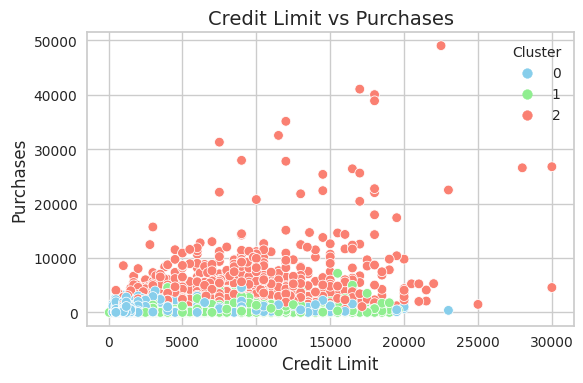

In [61]:
new_palette = ['skyblue', 'lightgreen', 'salmon']

sns.set_style("whitegrid")
sns.set_palette(new_palette)

plt.figure(figsize=(6, 4))
sns.scatterplot(data=Data, x='CREDIT_LIMIT', y='PURCHASES', hue='kmeans_3', palette=new_palette)
plt.title('Credit Limit vs Purchases', fontsize=14)
plt.xlabel('Credit Limit', fontsize=12)
plt.ylabel('Purchases', fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.legend(title='Cluster', fontsize=10, title_fontsize=10)
plt.tight_layout()
plt.show()

<div style="background-color: #E8F8F5; border-radius: 5px; padding: 10px; margin-bottom: 10px;">
  <span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Group 0:</span> These group of customers have a good credit limit, but the lowest "Purchases".
</div>

<div style="background-color: #E8F8F5; border-radius: 5px; padding: 10px; margin-bottom: 10px;">
  <span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Group 1:</span> These group of customers have the lowest "Credit_Limit" and "Purchases".
</div>

<div style="background-color: #E8F8F5; border-radius: 5px; padding: 10px; margin-bottom: 10px;">
  <span style="color:#F39C12; font-size:1.1em; font-weight:bold;">Group 2:</span> These group of customers have a good credit limit and they spend their money.
</div>


# 

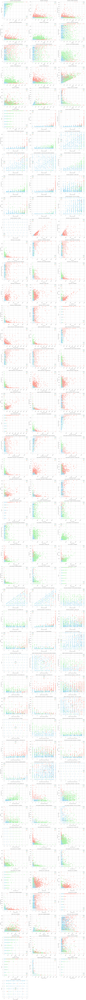

In [62]:
features = Data.columns[:-1]  
num_features = len(features)
num_plots_per_row = 3 

num_rows = (num_features * (num_features - 1)) // (2 * num_plots_per_row) + 1

fig, axes = plt.subplots(num_rows, num_plots_per_row, figsize=(20, 5 * num_rows), dpi=100)
axes = axes.flatten() 
index = 0
for i in range(len(features)):
    for j in range(i + 1, len(features)):
        if index < len(axes): 
            sns.scatterplot(data=Data, x=features[i], y=features[j], hue='kmeans_3', palette=new_palette, ax=axes[index])
            axes[index].set_title(f'{features[i]} vs {features[j]}', fontsize=10)
            axes[index].set_xlabel(features[i], fontsize=8)
            axes[index].set_ylabel(features[j], fontsize=8)
            axes[index].tick_params(axis='x', rotation=45, labelsize=8)
            axes[index].tick_params(axis='y', labelsize=8)
            axes[index].legend(title='Cluster', fontsize=8, title_fontsize=8)
            index += 1

for ax in axes[index:]:
    fig.delaxes(ax)
plt.tight_layout()
plt.show()

<span style="color:#27AE60; font-size:2em; font-weight:bold; text-shadow: 1px 1px 2px rgba(0,0,0,0.3);">🌟 Finish 🌟</span>